<a href="https://colab.research.google.com/github/sarychief/cv-tasks/blob/main/photo_preprocesing_basics_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from skimage import io 
# для считывания картинок

In [ ]:
import matplotlib
np.random.seed(0)
matplotlib.rcParams["figure.figsize"] = (10,7)

In [ ]:
img = io.imread('./mencken.jpg')

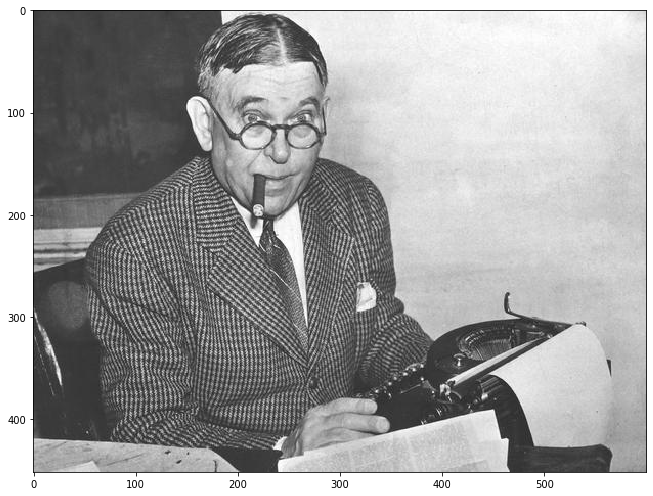

In [ ]:
io.imshow(img)

In [ ]:
img

array([[[ 61,  61,  61],
        [ 61,  61,  61],
        [ 60,  60,  60],
        ...,
        [208, 208, 208],
        [207, 207, 207],
        [207, 207, 207]],

       [[ 61,  61,  61],
        [ 61,  61,  61],
        [ 60,  60,  60],
        ...,
        [211, 211, 211],
        [210, 210, 210],
        [210, 210, 210]],

       [[ 61,  61,  61],
        [ 61,  61,  61],
        [ 60,  60,  60],
        ...,
        [213, 213, 213],
        [212, 212, 212],
        [212, 212, 212]],

       ...,

       [[186, 186, 186],
        [180, 180, 180],
        [176, 176, 176],
        ...,
        [146, 146, 146],
        [144, 144, 144],
        [145, 145, 145]],

       [[185, 185, 185],
        [178, 178, 178],
        [171, 171, 171],
        ...,
        [144, 144, 144],
        [141, 141, 141],
        [141, 141, 141]],

       [[177, 177, 177],
        [169, 169, 169],
        [164, 164, 164],
        ...,
        [143, 143, 143],
        [139, 139, 139],
        [139, 139, 139]]

In [ ]:
img.dtype
# от 0 до 255

dtype('uint8')

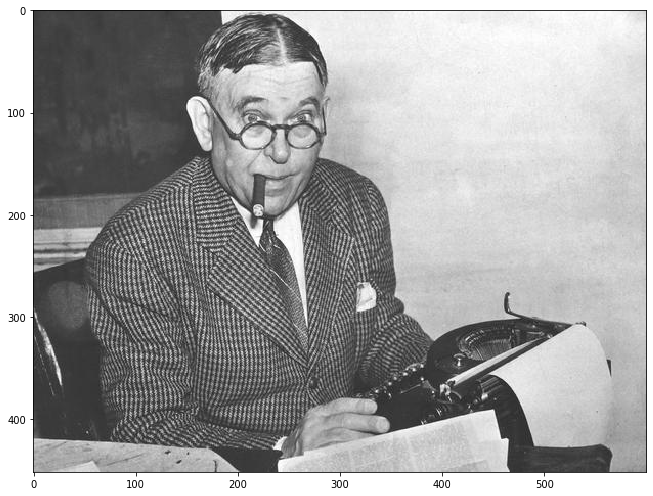

In [ ]:
# переведем во флоты 
imgf = img/255.0
io.imshow(imgf)

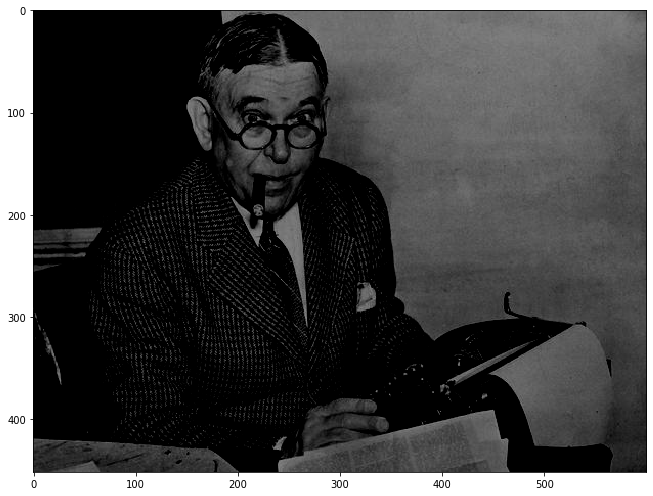

In [ ]:
io.imshow(np.clip(imgf - .5, 0, 1))
# задаем интервал для значений пикселей от 0 до 1

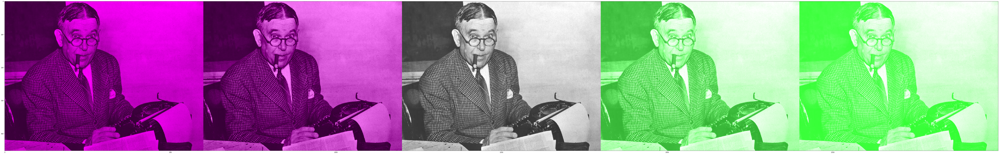

In [ ]:
plt.figure(figsize=(100,20))

new_img = imgf.copy()
array = []

for gamma in np.linspace(-1, 1, 5):
  changed = new_img.copy()
  changed[..., 1] += gamma
  # изменяем второй канал (зеленый)
  changed = np.clip(changed, 0, 1)
  array.append(changed)
array = np.concatenate(array, 1)
io.imshow(array)

---

## Гамма-коррекция

In [ ]:
from skimage import exposure

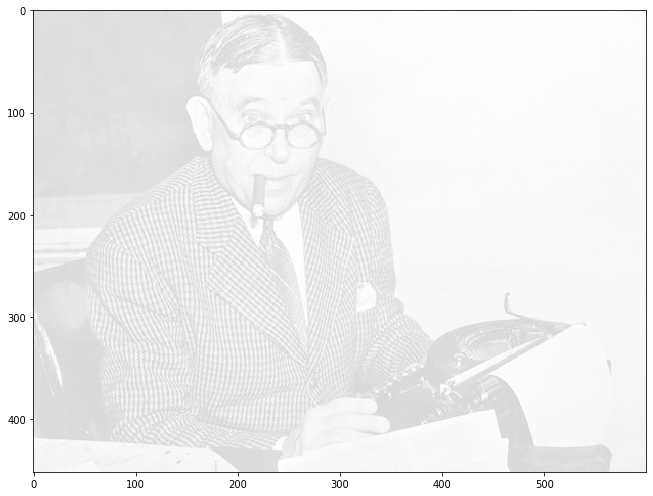

In [ ]:
gamma_correct = exposure.adjust_gamma(imgf, gamma=0.1)
io.imshow(gamma_correct)

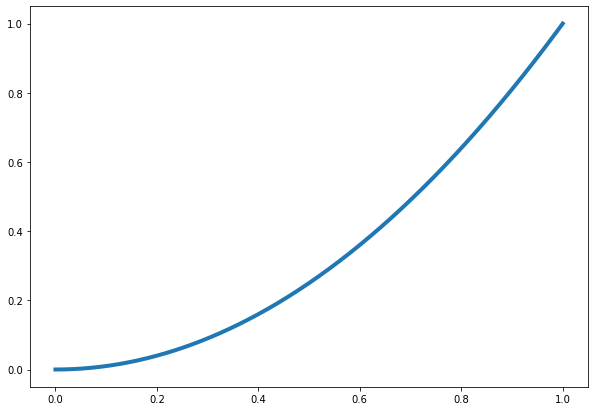

In [ ]:
dummy_image = np.linspace(0, 1, 500)[None]
adjusted = exposure.adjust_gamma(dummy_image, gamma=2)
plt.plot(dummy_image[0], adjusted[0], linewidth=4)

In [ ]:
from skimage import color

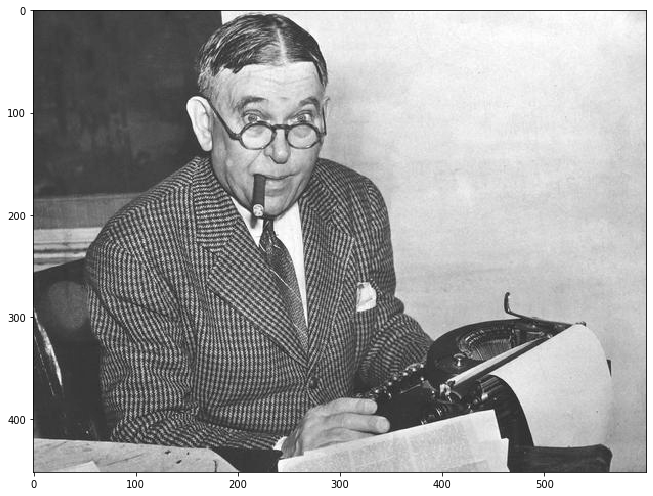

In [ ]:
grey_img = color.rgb2gray(imgf)
# хоть и чб, но картинка была трехканальная
io.imshow(grey_img)

In [ ]:
hsv_img = color.rgb2hsv(imgf)

In [ ]:
for i in range(3):
  print(hsv_img[...,i].min(), hsv_img[...,i].max())

0.0 0.0
0.0 0.0
0.06274509803921569 1.0


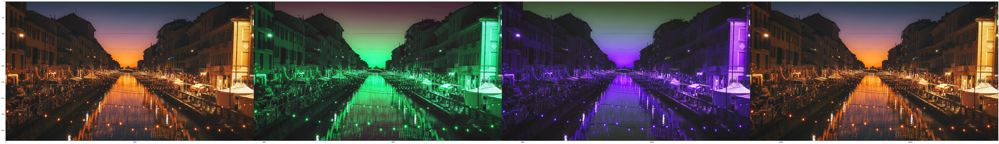

In [ ]:
plt.figure(figsize=(100,20))
iimg = io.imread("./milan.jpg")
new_img = color.rgb2hsv(iimg)
array = []

for add in np.linspace(0, 1, 4):
  changed = new_img.copy()
  changed[..., 0] += add
  changed[changed[...,0] > 1][...,0] -=1
  # если выходим за границы hsv, переходим в начало 
  array.append(changed)

array = np.concatenate(array, 1)
array = color.hsv2rgb(array)
io.imshow(array, interpolation='nearest')

In [ ]:
plt.figure(figsize=(100,20))
array2 = []

for add in np.linspace(0, 2, 4):
  changed = new_img.copy()
  changed[..., 1] *= add
  changed[..., 1] = np.clip(changed[..., 1], 0, 1)
  array2.append(changed)

array2 = np.concatenate(array, 1)
array2 = color.hsv2rgb(array)
io.imshow(array2, interpolation='nearest')